In [1]:
from pynth import *

import numpy as np
import matplotlib.pyplot as plt
from scipy import signal
import itertools
import IPython.display as ipd

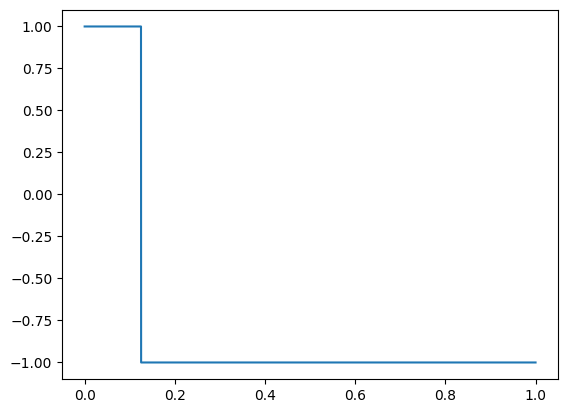

In [2]:
class Pulse(Oscillator):
    def __init__(self,  duty=1/8):
        self.duty = duty

    def take(self, p):
        return 1 if p < self.duty else -1


Pulse().plot()
ipd.display(Instrument(wav=Pulse(1/8)).audio())
ipd.display(Instrument(wav=Pulse(1/4)).audio())
ipd.display(Instrument(wav=Pulse(1/2)).audio())


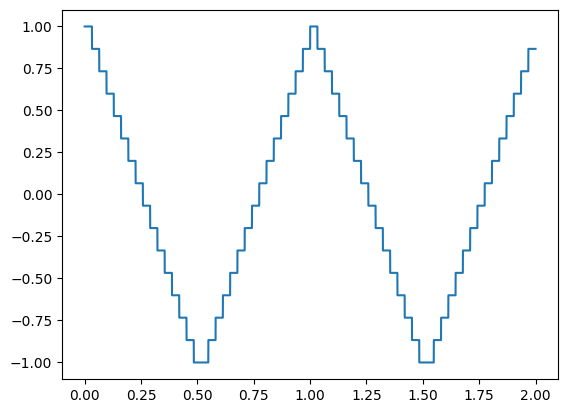

In [3]:
class Triangle(Oscillator):
    sample = np.array(list(range(15, -1, -1)) + list(range(16))) / 7.5 - 1 
    max_idx = len(sample) - 1

    def take(self, p):
        return self.sample[int(p * self.max_idx)]

Triangle().plot(2)
Instrument(wav=Triangle()).audio(80)

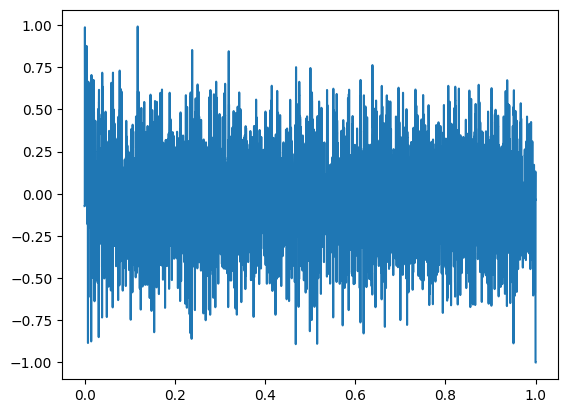

In [4]:
class Lfsr:
    def __init__(self):
        self.register = 0b000_0000_0000_0001

    def __iter__(self):
        return self

    def __next__(self):
        b0 = self.get_bit(0)
        b1 = self.get_bit(1)
        bx = b0 ^ b1
        self.shift(1)
        self.set_bit(14, bx)
        return 1 if b0 == 0 else -1

    def shift(self, n):
        self.register >>= n

    def get_bit(self, n):
        return self.register >> n & 1

    def set_bit(self, n, v):
        self.register = self.register | (v << n)


class Noise(Oscillator):
    len_sample = int(SAMPLING_RATE / (1789773/4) * 32767)
    sample = normalize(signal.resample(
        list(itertools.islice(Lfsr(), 32767)), len_sample)) 

    def take(self, p):
        return self.sample[int(p * self.len_sample)]


Xf = N(1789773 / 32767 / 4)
Xe = N(1789773 / 32767 / 8)
Xd = N(1789773 / 32767 / 16)
Xc = N(1789773 / 32767 / 32)
Xb = N(1789773 / 32767 /   64*10)
Xa = N(1789773 / 32767 /   96*10)
X9 = N(1789773 / 32767 /  128*10)
X8 = N(1789773 / 32767 /  160*10)
X7 = N(1789773 / 32767 /  202*10)
X6 = N(1789773 / 32767 /  254*10)
X5 = N(1789773 / 32767 /  380*10)
X4 = N(1789773 / 32767 /  508*10)
X3 = N(1789773 / 32767 /  762*10)
X2 = N(1789773 / 32767 / 1016*10)
X1 = N(1789773 / 32767 / 2034*10)
X0 = N(1789773 / 32767 / 4068*10)

Noise().plot()
Instrument(wav=Noise()).audio(X0.freq)

In [5]:
class Mml(Oscillator):
    def __init__(self, start, end=[], loop=[], proc=None):
        self.start = np.array(start)
        self.end = np.array(end)
        self.loop = np.array(loop if loop else [start[-1]])
        if proc:
            self.start = proc(self.start)
            self.end = proc(self.end)
            self.loop = proc(self.loop)

    def take(self, p, t, d):
        n = int((d - t) / 0.016)
        if n < self.end.size:
            return self.end[n]

        n = int(t / 0.016)
        if n < self.start.size:
            return self.start[n]

        n = (n - self.start.size) % self.loop.size
        return self.loop[n]

In [6]:
class Mixer(Score.Mixer):
    def mix(self, tracks):
        return normalize(
            tracks['guitar1'] * 0.35 +
            tracks['guitar2'] * 0.35 +
            tracks['bass'] +
            tracks['drum']
        )


s = Score(
    title="Rock Man II - Title Screen",
    tempo=180,
    parts=['guitar1', 'guitar2', 'bass', 'drum'],
    mixer=Mixer()
)


In [7]:
guitar1_motif = [C(5)/8, C/16, C]*2 + [C/8, D, R, +A(4)/1]
guitar2_motif = [G(4)/8, G/16, G]*2 + [G/8, G, R,  F(4)/1]


guitar1_phrase1 = []
guitar2_phrase1 = []
guitar1_phrase1 += guitar1_motif
guitar2_phrase1 += guitar2_motif
guitar1_phrase1 += [+A(4)/8, +G, +G/16, +G, +G/8, F, R, F, R, G/2]
guitar2_phrase1 += [ G(4)/8, +D, +D/16, +D, +D/8, D, R, D, R, E/2]
guitar1_phrase1 += [G/8, +G, +A, R/4]
guitar2_phrase1 += [E/8, +D,  F, R/4]


guitar1_phrase2 = []
guitar2_phrase2 = []
guitar1_phrase2 += guitar1_motif
guitar2_phrase2 += guitar2_motif
guitar1_phrase2 += [+A(4)/8, +G/4, +G/8, +A, R, +A, R, C(5)/1*(5/8)]
guitar2_phrase2 += [ G(4)/8, +D/4, +D/8,  F, R,  F, R, G(4)/1*(5/8)]
guitar1_phrase2 += [let(wav=Pulse(1/2), p8=6, dur=1/16),    G, F, +D, F, +D, D, +C, C, let(wav=Pulse(1/8))]
guitar2_phrase2 += [let(wav=Pulse(1/2), p8=6, dur=1/16), R, G, F, +D, F, +D, D, +C,    let(wav=Pulse(1/8))]


guitar1_solo = [let(wav=Pulse(1/4))]
guitar2_solo = [let(wav=Pulse(1/4))]

guitar1_solo += [C(5)/8,    C,    G(4), E, E(5), C, G(4), G(5)/4, F/8, E, D, E, C/4,    R/8]
guitar2_solo += [G(4)/8, R, C(5), G(4), E, E(5), C, G(4), G(5)/4, F/8, E, D,    G(4)/4, R/8]

guitar1_solo += [+A(4)/8,    +A, A, F, D(5)/4, +A(4)/8, G, +A(4)/16, +A, F, D(5), +A, F, D, +A, F/8, +A(4)/4, R/8]
guitar2_solo += [ F(4)/8, R, +A, A, F, D(5)/4, +A(4)/8, G, +A(4)/16, +A, F, D(5), +A, F, D, +A,       F(4)/4, R/8]

guitar1_solo += [A(4)/8      ] + [A(4)/16, C(5), A(4), E, C/8]*2 + [A(4)/16, C(5), +G, A, +G, A, +G, A, E, C, R, R, A(4)/4, R/8]
guitar2_solo += [E(4)/8, R/16] + [A(4)/16, C(5), A(4), E, C/8]*2 + [A(4)/16, C(5), +G, A, +G, A, +G, A, E, C, R,    E(4)/4, R/8]

guitar1_solo += [ C(4)/16*1.5, +D, +G,    +D,   +G,     C(5), +G(4), C(5), +D,  C, +D, +G   ]
guitar2_solo += [+D(4)/16*1.5, +G,  C(5), +G(4), C(5), +D,     C,   +D,    +G, +D, +G,  C(6)]

guitar1_solo += [+G(4)/8, +G(4), +G, +G, R, +A/4, R/8]
guitar2_solo += [+D(4)/8, +D,    +D, +D, R,  F/4, R/8]

guitar1_solo += [let(wav=Pulse(1/8))]
guitar2_solo += [let(wav=Pulse(1/8))]


guitar1_outro = guitar1_motif + [G(4)/8, G, A, C(5), R] + [G(4), A, C(5), R]*2 + [G(5), A, C(6)]
guitar2_outro = guitar2_motif + [E(4)/8, E, F, G,    R] + [E(4), F, G,    R]*2 + [E(5), F, G   ]

guitar = {
    'wav': Pulse(1/8),
    'amp': Mml([0xF], end=[0x0], proc=lambda x: x / 0xF),
}

s['guitar1'] = [let(**guitar)]
s['guitar1'] += guitar1_phrase1
s['guitar1'] += guitar1_phrase2
s['guitar1'] += guitar1_phrase1
s['guitar1'] += guitar1_phrase2
s['guitar1'] += guitar1_solo
s['guitar1'] += guitar1_phrase1
s['guitar1'] += guitar1_outro

s['guitar2'] = [let(**guitar)]
s['guitar2'] += guitar2_phrase1
s['guitar2'] += guitar2_phrase2
s['guitar2'] += guitar2_phrase1
s['guitar2'] += guitar2_phrase2
s['guitar2'] += guitar2_solo
s['guitar2'] += guitar2_phrase1
s['guitar2'] += guitar2_outro

s.audio(['guitar1', 'guitar2'])

In [8]:
bass = {
    'wav': Triangle(),
    'amp': Mml([0xF], end=[0x0], proc=lambda x: x / 0xF),
}

bass_repeat = [C(4)/8, C/16, C]

s['bass'] = [
    let(**bass),
    *bass_repeat*64,
    *[R/8]*65,
    *bass_repeat*24,
    *[C(4)/8, D, E, R]*4,
]

s.audio(['bass'])

In [9]:
drum = {
    'wav': Noise(),
    'amp': Mml([0xF, 0x5, 0x5, 0x0], proc=lambda x: x / 0xF),
}
snare = {
    'amp':  Mml([0xF, 0xF, 0xF, 0x7, 0x7, 0x7, 0x7, 0x0], proc=lambda x: x / 0xF),
    'freq': Mml([0x1, 0x1, 0x2, 0x3, 0x5, 0x1, 0x7, 0x0]),
}

drum_repeat = [Xd/16, R, Xd, Xd, X4.that(**snare)/8, Xd/16, Xd]

s['drum'] = [
    let(**drum),
    *drum_repeat*60,
    Xd/8, Xd, Xd, Xd, R, *[Xd, Xd, Xd, R]*3
]

s.audio(['drum'])

In [10]:
s.audio()